In [6]:
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline

from src.guided_filter import guided_filter, guided_filter_with_colored_guide

In [7]:
%load_ext autoreload
%autoreload 2

In [8]:
def plot_before_after(before, after):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))
    axes[0].imshow(before)
    axes[0].set_title('before filtering')
    axes[0].axis('off')
    axes[1].set_title('after filtering')
    axes[1].imshow(after)
    axes[1].axis('off')

In [19]:
image_folder = os.path.join("dataset", "guided_filter_tests")
imrgb1 = plt.imread(os.path.join(image_folder, "kandinsky.jpg"))/255
imrgb2 = plt.imread(os.path.join(image_folder, "gauguin.jpg"))[:imrgb1.shape[0], :imrgb1.shape[1]]/255
noisy_imrgb1 = np.clip(imrgb1 + np.random.normal(0, 0.2, imrgb1.shape), 0, 1)

# useful if the image is a png with a transparency channel
imrgb1=imrgb1[:,:,0:3]
imrgb2=imrgb2[:,:,0:3]

(-0.5, 619.5, 433.5, -0.5)

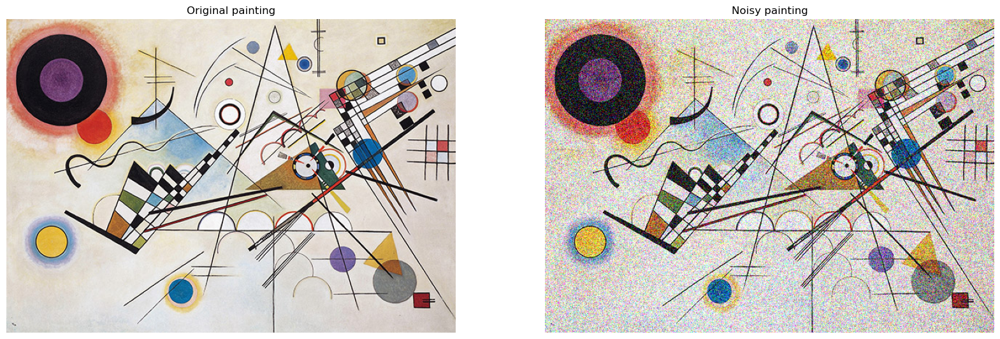

In [10]:
fig, axes = plt.subplots(1, 2, figsize=(20, 10))
axes[0].imshow(imrgb1)
axes[0].set_title('Original painting')
axes[0].axis('off')
axes[1].imshow(noisy_imrgb1)
axes[1].set_title('Noisy painting')
axes[1].axis('off')

# Various window size

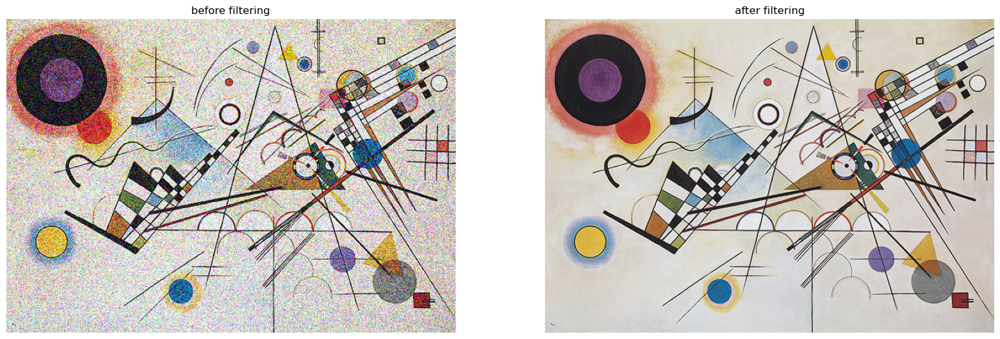

In [11]:
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb1[:,:,i], 20,1e-4 )
plot_before_after(noisy_imrgb1, out)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


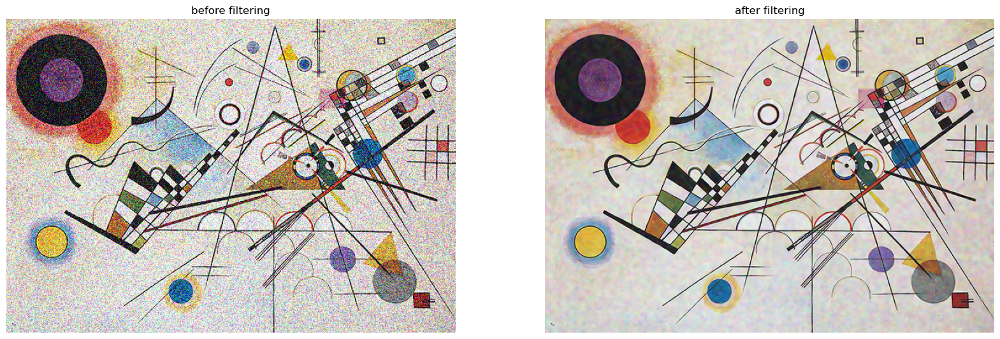

In [12]:
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb1[:,:,i], 2,1e-4 )
plot_before_after(noisy_imrgb1, out)

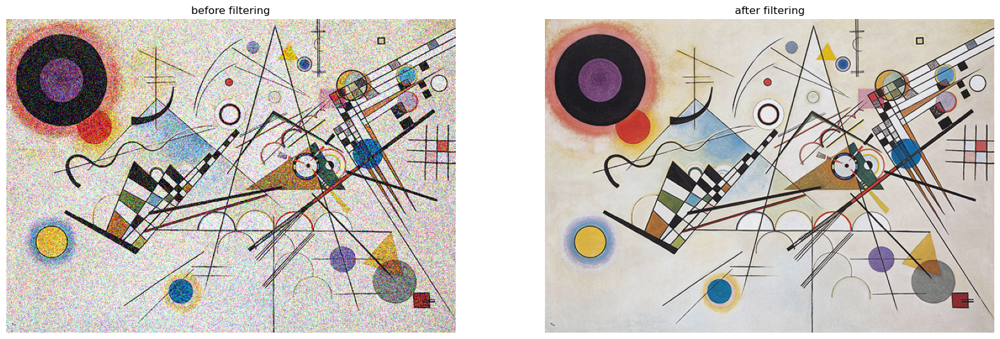

In [13]:
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb1[:,:,i], 200,1e-4 )
plot_before_after(noisy_imrgb1, out)

# Various epsilon

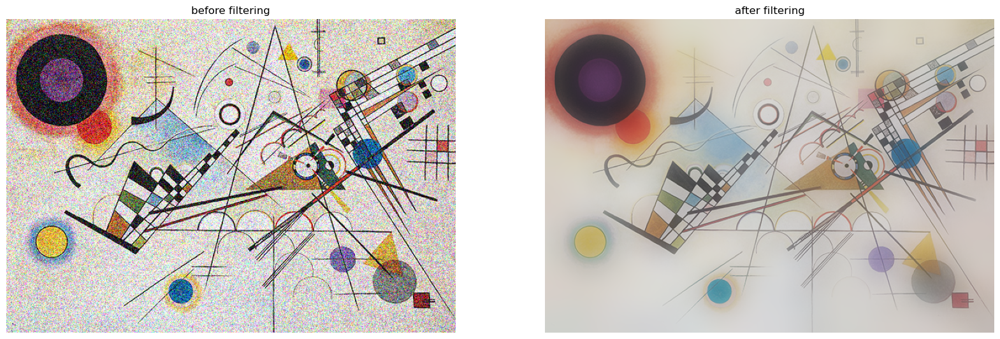

In [14]:
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb1[:,:,i], 20,1e-1 )
plot_before_after(noisy_imrgb1, out)

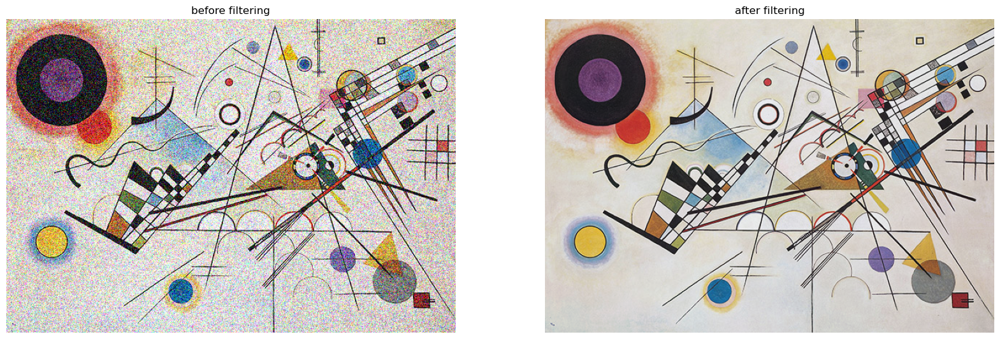

In [15]:
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb1[:,:,i], 20,0 )
plot_before_after(noisy_imrgb1, out)

# Other image as guide

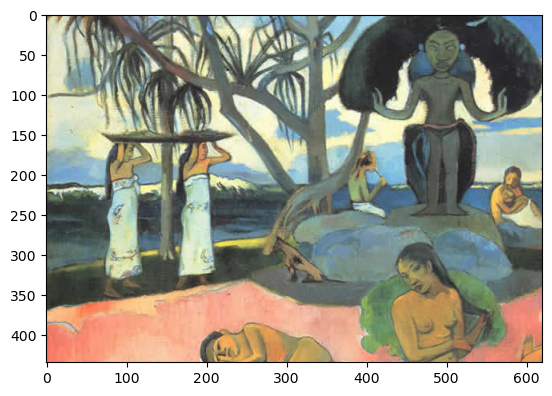

In [20]:
plt.imshow(imrgb2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


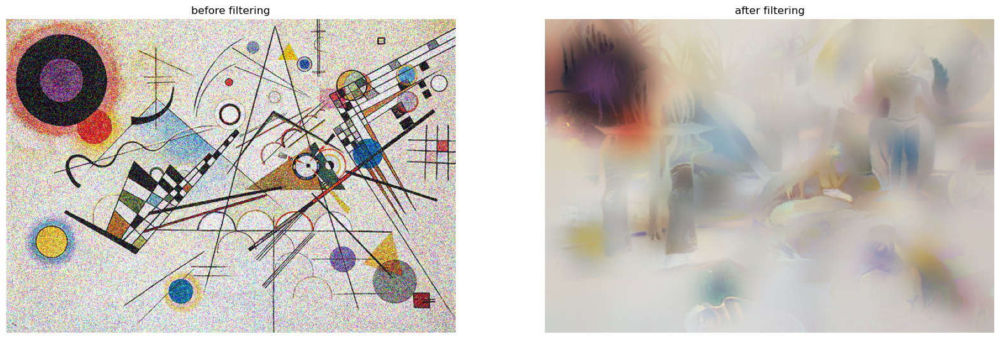

In [21]:
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb2[:,:,i], 20,1e-4 )
plot_before_after(noisy_imrgb1, out)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


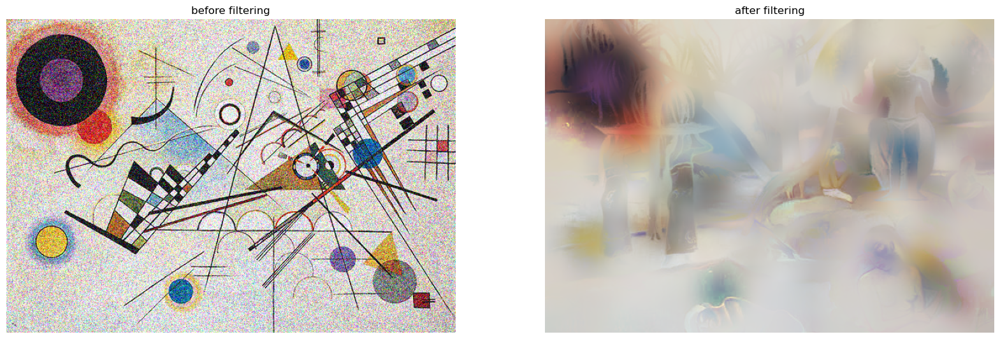

In [22]:
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb2[:,:,i], 20,0 )
plot_before_after(noisy_imrgb1, out)

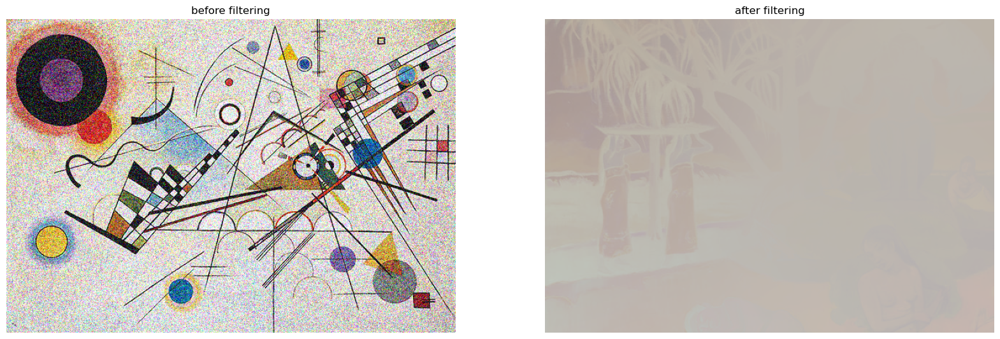

In [23]:
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb2[:,:,i], 200,1e-4 )
plot_before_after(noisy_imrgb1, out)

# Different strategies for coloured guide

## Grayscale

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 619.5, 433.5, -0.5)

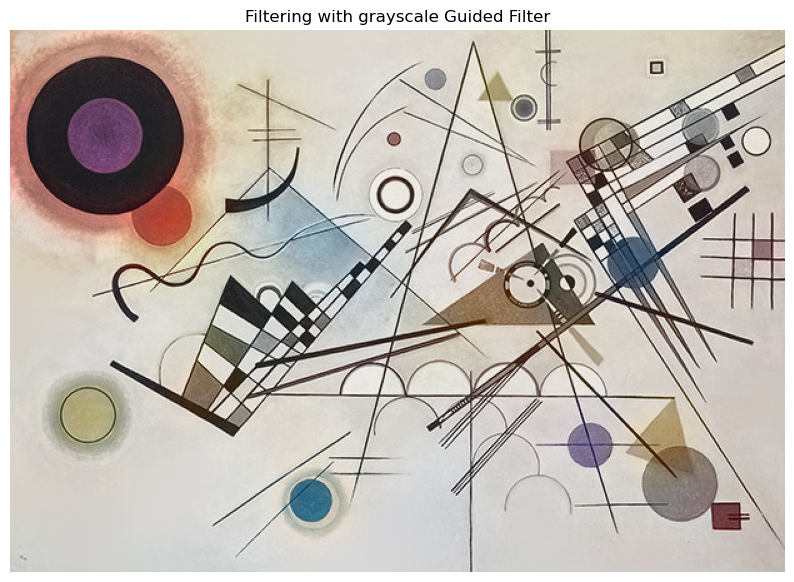

In [24]:
out = np.zeros_like(noisy_imrgb1)
grayscale_guide = np.mean(imrgb1, axis=2)
for i in range(3):
    out[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], grayscale_guide, 20,1e-3 )
# plot_before_after(noisy_imrgb1, out)
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))
ax.imshow(out)
ax.set_title('Filtering with grayscale Guided Filter')
ax.axis('off')

## Channel by channel

(-0.5, 619.5, 433.5, -0.5)

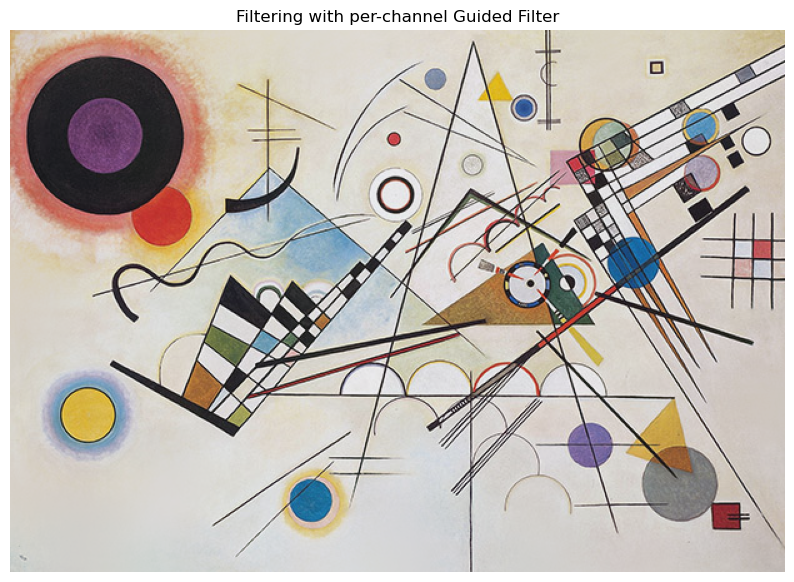

In [25]:
out_channel = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out_channel[:,:,i] = guided_filter(noisy_imrgb1[:,:,i], imrgb1[:,:,i], 20,1e-3)
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))
ax.imshow(out_channel)
ax.set_title('Filtering with per-channel Guided Filter')
ax.axis('off')

## Article

(-0.5, 619.5, 433.5, -0.5)

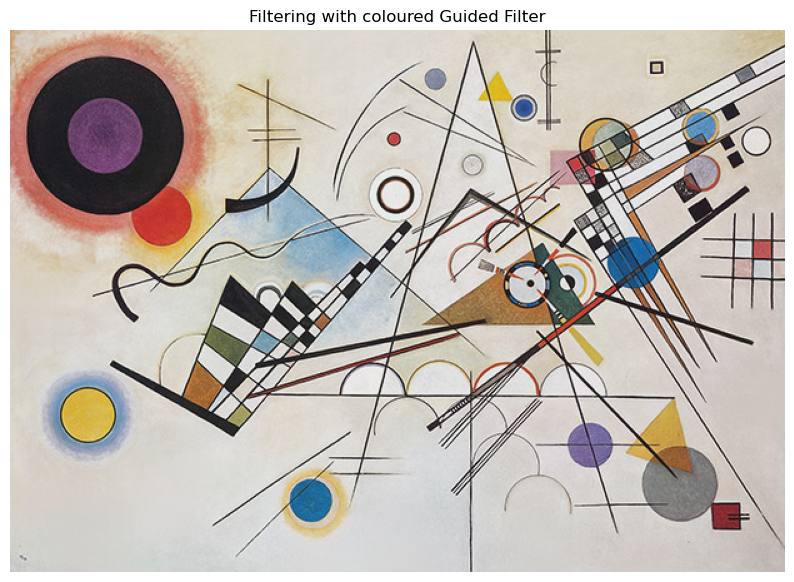

In [26]:
# V2
imgrgb1 = imrgb1
noisy_imrgb1 = noisy_imrgb1
out = np.zeros_like(noisy_imrgb1)
for i in range(3):
    out[:,:,i] = guided_filter_with_colored_guide(noisy_imrgb1[:,:,i], imrgb1, 20,1e-3)
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))
ax.imshow(out)
ax.set_title('Filtering with coloured Guided Filter')
ax.axis('off')

## OpenCV

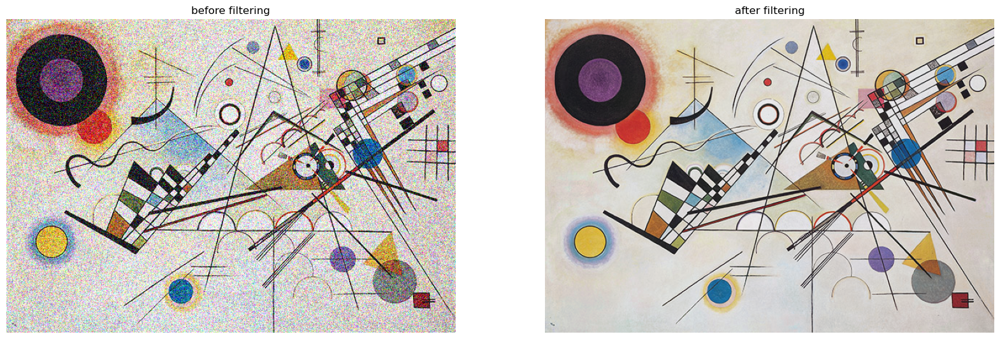

In [27]:
# OpenCV
from cv2.ximgproc import guidedFilter

# Convert images into uint8
noisy_imrgb1_n = np.uint8(255*noisy_imrgb1)
imrgb1_n = np.uint8(255*imrgb1)

out = np.zeros_like(noisy_imrgb1_n)
out = guidedFilter(imrgb1_n, noisy_imrgb1_n, 20, 1e-3)
plot_before_after(noisy_imrgb1_n, out)